# Visualizing Linear Transformations

## Primitives

In [1]:
def identity():
    def id(t):
        I = [[1, 0], [0, 1]]
        return matrix(I)
    return id

def rotation(theta):
    def rot(t):
        A = [[cos(theta*t), -sin(theta*t)],
            [sin(theta*t), cos(theta*t)]]
        return matrix(A)
    return rot

def reflection(theta):
    # make a vector orthogonal to the angle given for the Householder transformation
    v = vector([cos(theta + pi/2), sin(theta + pi/2)])
    I = identity()
    def ref(t):
        A = I(t) - 2*t*v.outer_product(v)
        return matrix(A)
    return ref
    
def scaling(d1, d2):
    def scl(t):
        A = [[(1-t) + d1*t, 0], [0, (1-t) + d2*t]]
        return matrix(A)
    return scl

In [4]:
var('t')
show(identity()(t), rotation(pi/2)(t), reflection(pi/2)(t), scaling(3/4, 2)(t))

[1 0]
[0 1] [ cos(1/2*pi*t) -sin(1/2*pi*t)]
[ sin(1/2*pi*t)  cos(1/2*pi*t)] [-2*t + 1        0]
[       0        1] [-1/4*t + 1          0]
[         0      t + 1]

## Plotting And Animation

In [3]:
def transformed_circle_coords(A, x):
    return vector(matrix(A)*matrix(2, 1, [cos(x), sin(x)]))

def plot_transformed_circle(A, alpha=1.0):
    A = matrix(RDF, A)
    c = parametric_plot(transformed_circle_coords(A, x), (x, 0, 2*pi+0.1),
                        color = "black", alpha=alpha)
    c_1 = parametric_plot(transformed_circle_coords(A, x), (x, -pi, 0),
                          alpha=0.0,
                          fill=True, fillcolor = "blue", fillalpha=alpha*0.25)
    c_2 = parametric_plot(transformed_circle_coords(A, x), (x, pi/2, 3*pi/2),
                          alpha=0.0,
                          fill=True, fillcolor = "red", fillalpha=alpha*0.1)
    v_1 = plot(A * vector([0, 1]), 
               rgbcolor = (1.0, 1.0-alpha, 1.0-alpha))
    v_2 = plot(A * vector([1, 0]),
               rgbcolor = (1.0-alpha, 1.0-alpha, 1.0))               
    return plot(c + c_1 + c_2 + v_1 + v_2)

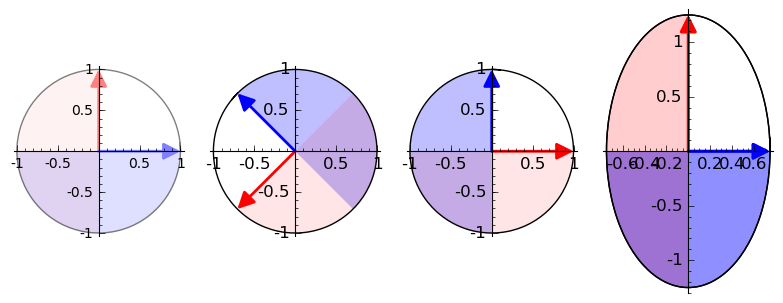

In [47]:
primitives = graphics_array((plot_transformed_circle(identity()(1.0), alpha = 0.5),
                            plot_transformed_circle(rotation(3*pi/4)(1.0), alpha = 1.0),
                            plot_transformed_circle(reflection(pi/4)(1.0), alpha = 1.0),
                            plot_transformed_circle(scaling(0.75, 1.25)(1.0), alpha = 1.0)))
primitives.save("primitives.png")
primitives

In [4]:
e_1 = vector([1, 0])
e_2 = vector([0, 1])

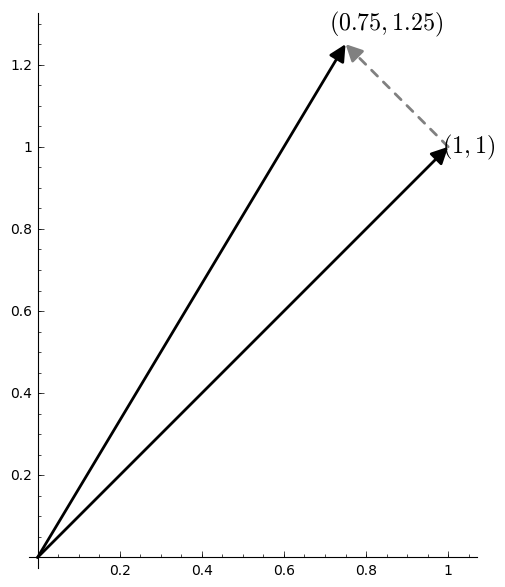

In [35]:
A_scaling = matrix(RDF, [[0.75, 0], [0, 1.25]])
vector_scaled = A_scaling * (e_1 + e_2)
img = (plot(e_1 + e_2, color = "black", aspect_ratio = 1) + 
 plot(vector_scaled, color = "black") + 
 arrow2d((1, 1), (0.75, 1.25), linestyle = "dashed", color = "gray") +
 text("$(1, 1)$", (1.05, 1), fontsize = "x-large", color = "black") +
 text("$(0.75, 1.25)$", (0.85, 1.30), fontsize = "x-large", color = "black"))
img.save("vector-scaled.png")
img

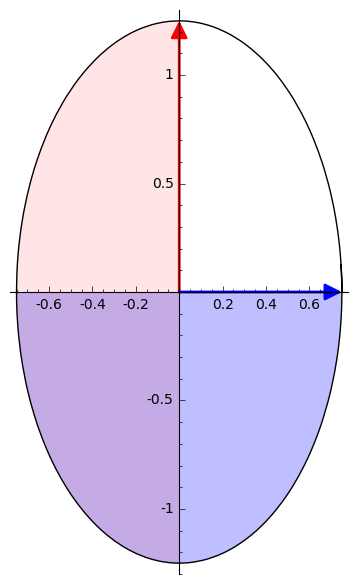

In [75]:
img = plot_transformed_circle(scaling(0.75, 1.25)(1.0))
img.save("circle-scaled.png")
img

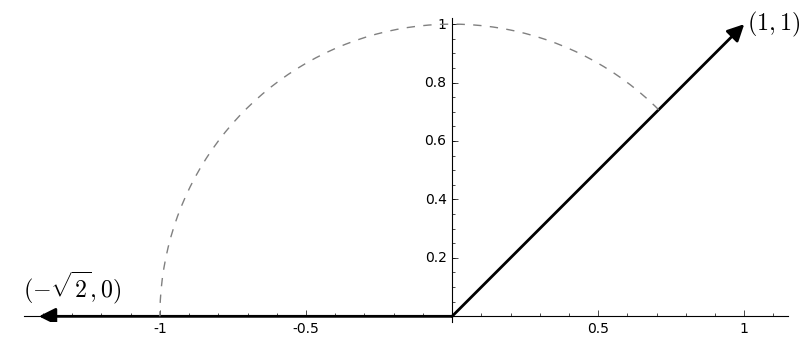

In [9]:
A_rotation = rotation(3*pi/4)(1.0)
vector_rotated = A_rotation * (e_1 + e_2)
img = (plot(e_1 + e_2, color = "black") + 
 plot(vector_rotated, color = "black") + 
 arc(center = (0, 0), r1 = 1, angle = pi/4, sector = (0, 3*pi/4), linestyle = "dashed", color = "gray") +
 text("$(1, 1)$", (1.1, 1), fontsize = "x-large", color = "black") +
 text("$(-\sqrt{2}, 0)$", (-1.3, .1), fontsize = "x-large", color = "black"))
img.save("vector-rotated.png")
img

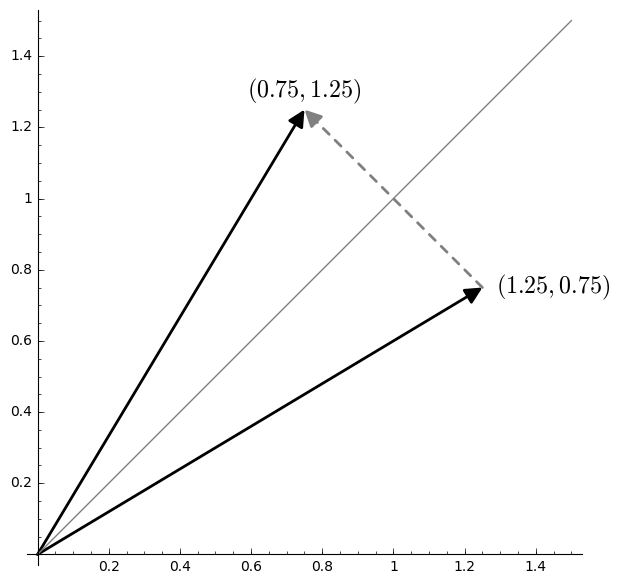

In [20]:
A_reflection = reflection(pi/4)(1.0)
vector_reflected = A_reflection * (1.25*e_1 + 0.75*e_2)
img = (plot(1.25*e_1 + 0.75*e_2, color = "black", aspect_ratio = 1) + 
 plot(vector_reflected, color = "black") + 
 arrow2d((1.25, 0.75), (0.75, 1.25), linestyle = "dashed", color = "gray") +
 line([(0,0), (1.5, 1.5)], color = "gray") +
 text("$(1.25, 0.75)$", (1.45, 0.75), fontsize = "x-large", color = "black") +
 text("$(0.75, 1.25)$", (0.75, 1.30), fontsize = "x-large", color = "black"))
img.save("vector-reflected.png")
img

In [4]:
def animate_transformation(A, I = matrix.identity(2), steps = 50, end_pause = 5, **args):
    B = lambda(t): A(t) * I
    frames = []
    start = plot_transformed_circle(B(0.0), alpha = 0.1)
    end = plot_transformed_circle(B(1.0), alpha = 0.1)
    for t in srange(0, 1, 1/steps):
        transition = plot_transformed_circle(B(t), alpha = 1.0)
        frames.append(start + end + transition)
    end = plot_transformed_circle(B(1.0), alpha = 1.0)
    for _ in range(end_pause):
        frames.append(start + end)
    return animate(frames, xmin=-2, xmax=2, ymin=-2, ymax=2)

Animation with 60 frames
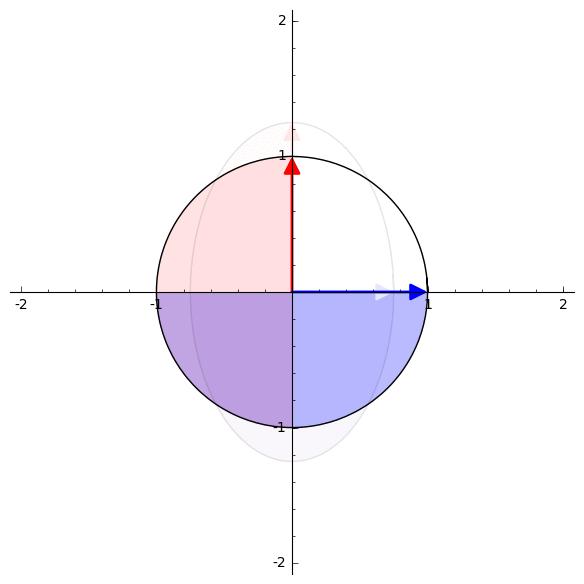

In [34]:
scaled_gif = animate_transformation(scaling(0.75, 1.25), steps = 50, end_pause = 10)
scaled_gif.save("scaling.gif", delay = 0)
scaled_gif

Animation with 110 frames
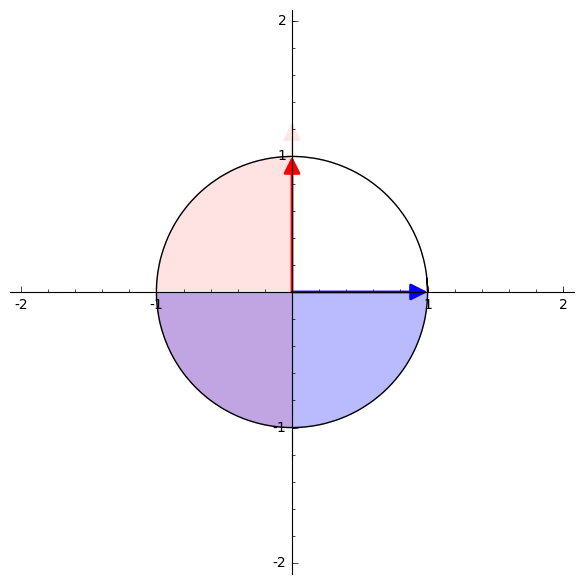

In [91]:
collapsed_gif = animate_transformation(scaling(0.0, 1.25), steps = 100, end_pause = 10)
collapsed_gif.save("collapsed.gif", delay = 0)
collapsed_gif

Animation with 60 frames
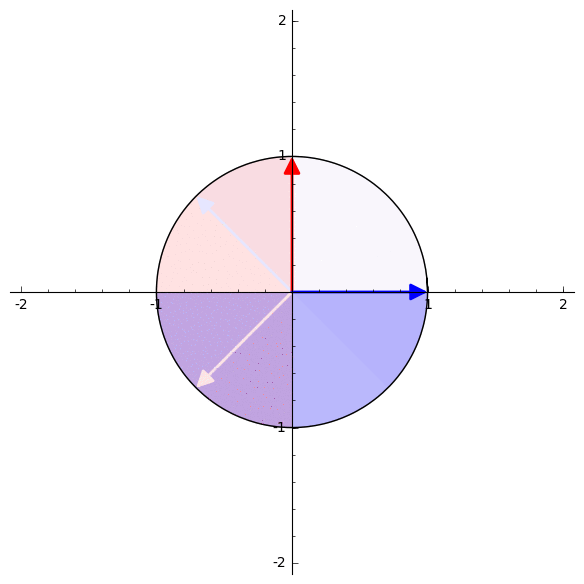

In [103]:
rotation_gif = animate_transformation(rotation(3*pi/4), frames = 100, end_pause = 10)
rotation_gif.save("rotation.gif", delay = 0)
rotation_gif

Animation with 60 frames
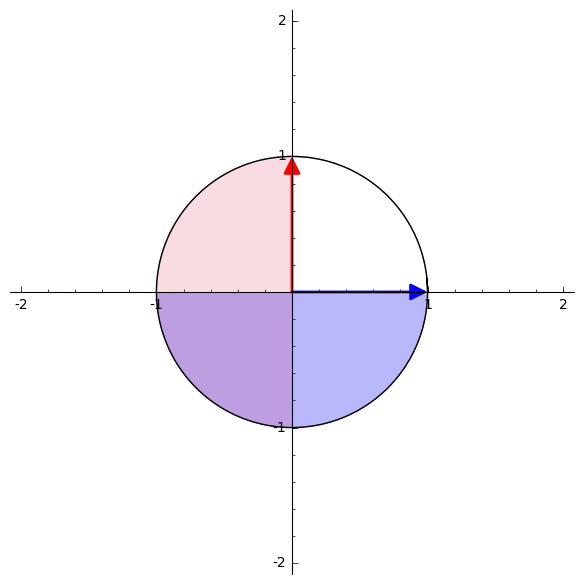

In [92]:
reflection_gif = animate_transformation(reflection(pi/4), frames = 100, end_pause = 10)
reflection_gif.save("reflection.gif", delay = 0)
reflection_gif

## Combining Transformations

In [5]:
def interpolate(*ff):
    ff = list(ff)
    ff.reverse()
    n = float(len(ff))
    def transformation(t):
        result = 1
        for k, f in enumerate(ff):
            if t < k/n:
                result = f(0.0) * result
            elif k/n <= t <= (k/n + 1/n):
                result = f(n*t - k) * result
            else:
                result = f(1.0) * result
        return result
    return transformation

[0.50 -1.5]
[0.50  1.5]

Animation with 50 frames
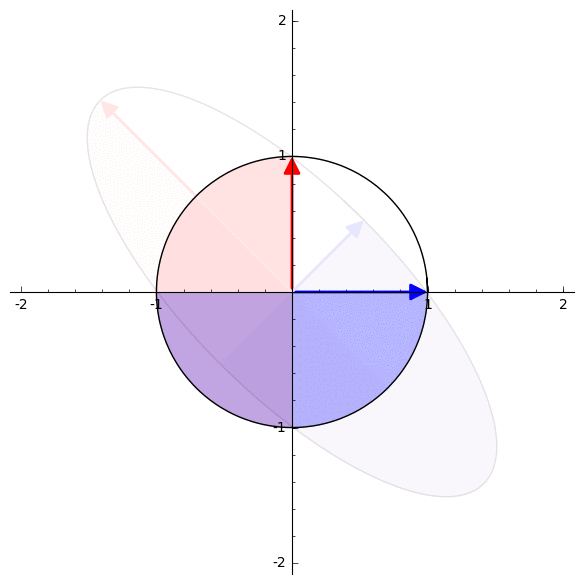

In [15]:
A = interpolate(rotation(pi/4), scaling(0.75, 2))
show(A(1.0).n(2))
animate_transformation(A, steps = 50)

In [12]:
A = interpolate(reflection(pi/4), rotation(-pi/3), scaling(0.75, 1.25))
show(A(1.0).n(2))
animate_transformation(A, steps = 50)

[-0.50  0.50]
[ 0.38  0.75]

Animation with 50 frames

## Factoring Transformations

In [6]:
def make_reflection_rotation(U):
    # check for rotation
    if round(U[0,0]) == round(U[1,1]) and round(det(U)) == 1:
        # \theta = \sgn(\sin \theta) \arccos(\cos \theta)
        theta = sgn(U[1,0])*arccos(U[0,0])
        print("rot", theta)
        return rotation(theta)
    # if it's not a rotation, it's a reflection
    else:
        # \theta = \frac{1}{2} \sgn(\sin 2\theta) \arccos(\cos 2\theta)
        theta = sgn(U[1,0])*0.5*arccos(U[0,0])
        print("ref", theta)
        return reflection(theta)

def factor_and_interpolate(A):
    A = matrix(RDF, A)
    U, S, V = A.SVD()
    show(U, S, V)
    U_t = make_reflection_rotation(U)
    S_t = scaling(S[0,0], S[1, 1])
    V_t = make_reflection_rotation(V.transpose())
    A_t = interpolate(U_t, S_t, V_t)
    return A_t

[1.0 0.0]
[0.0 1.0] [2.0 0.0]
[0.0 1.0] [1.0 0.0]
[0.0 1.0]

('rot', 0.0)
('rot', 0.0)


[ 2.0 0.00]
[0.00  1.0]

Animation with 55 frames
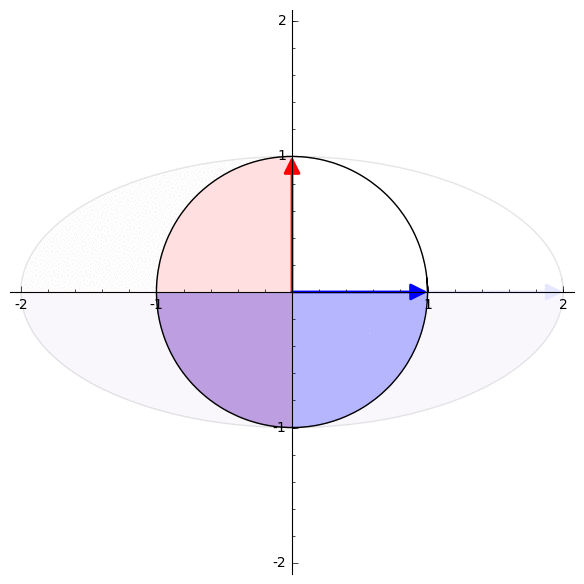

In [504]:
A = factor_and_interpolate([[2, 0], [0, 1]])
show(A(1.0).n(2))
animate_transformation(A, steps = 50)

[ 2.0 0.00]
[0.00  1.0]

[-0.7071067811865475 -0.7071067811865474]
[-0.7071067811865474  0.7071067811865475] [2.0000000000000004                0.0]
[               0.0 0.9999999999999998] [-0.7071067811865475  0.7071067811865475]
[-0.7071067811865475 -0.7071067811865475]

('ref', -1.17809724509617)
('rot', 2.356194490192345)


Animation with 210 frames
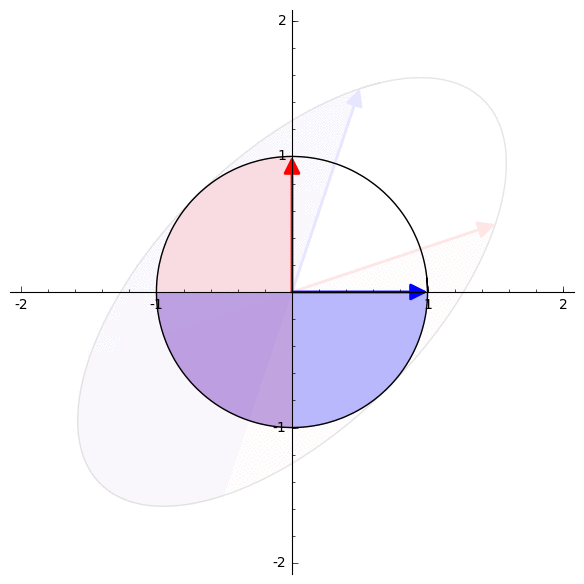

In [505]:
show(A(1.0).n(2))
A = factor_and_interpolate([[0.5, 1.5], [1.5, 0.5]])
a = animate_transformation(A, steps = 200, end_pause = 10)
a.save("rot-scale-ref.gif", delay = 0)
show(a)

[-1.0  0.0]
[ 0.0 -1.0] [2.0 0.0]
[0.0 1.0] [ 0.0 -1.0]
[ 1.0 -0.0]

('rot', 0.0)
('rot', -1.5707963267948966)


[1.1e-16     2.0]
[   -1.0 5.6e-17]

Animation with 210 frames
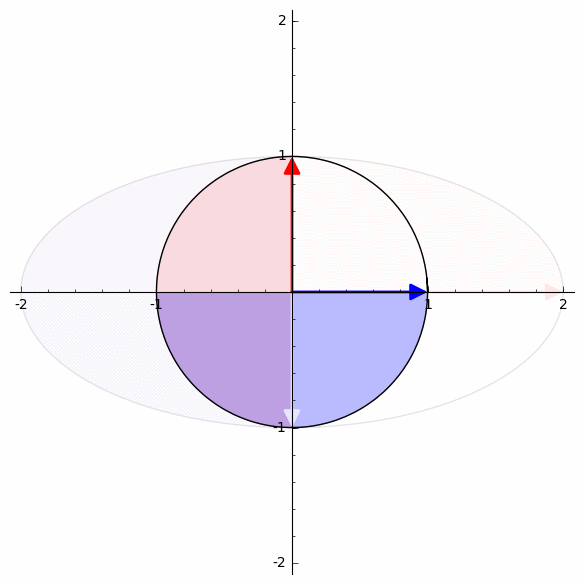

In [506]:
A = factor_and_interpolate([[0, -2], [1, 0]])
show(A(1.0).n(2))
a = animate_transformation(A, steps = 200, end_pause = 10)
a.save("rot-scale-rot.gif", delay = 0)
show(a)

[ 0.8506508083520399 -0.5257311121191336]
[ 0.5257311121191336  0.8506508083520399] [ 1.618033988749895                0.0]
[               0.0 0.6180339887498948] [0.5257311121191336  -0.85065080835204]
[  0.85065080835204 0.5257311121191336]

('rot', 0.5535743588970453)
('rot', -1.0172219678978514)


[    1.0     1.0]
[2.2e-16     1.0]

Animation with 210 frames
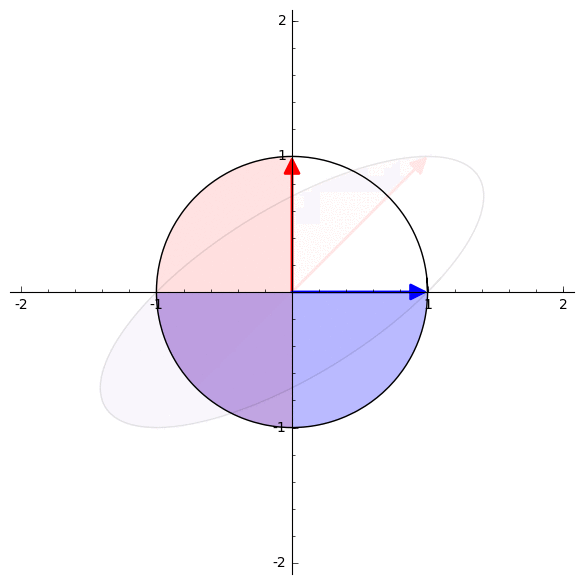

In [508]:
A = factor_and_interpolate([[1, 1], [0, 1]])
show(A(1.0).n(2))
a = animate_transformation(A, steps = 200, end_pause = 10)
a.save("shear.gif", delay = 0)
show(a)

## Eigenvalues and Singular Values

In [97]:
def plot_eigen_circle(A, alpha=1.0):
    A = matrix(RDF, A)
    c = (parametric_plot(transformed_circle_coords(A, x), (x, 0, 2*pi+0.1),
                        color = "black", alpha=alpha) +
         parametric_plot(vector([cos(x), sin(x)]), (x, 0, 2*pi+0.1),
                        color = "black", alpha=alpha*0.5))
    eigenvectors = A.eigenmatrix_right()[1]
    ev_1 = vector(eigenvectors[:, 0])
    ev_2 = vector(eigenvectors[:, 1])
    v_1 = (plot(ev_1,
              rgbcolor = (1.0, 1.0-alpha*0.5, 1.0-alpha*0.5)) +
           plot(A * ev_1,
               rgbcolor = (1.0, 1.0-alpha, 1.0-alpha)))
    v_2 = (plot(ev_2,
              rgbcolor = (1.0-alpha*0.5, 1.0-alpha*0.5, 1.0)) +
           plot(A * ev_2,
               rgbcolor = (1.0-alpha, 1.0-alpha, 1.0)))
    return plot(c + v_1 + v_2)

[(2, [
  (1, 1)
  ], 1), (-2, [
  (1, -1)
  ], 1)]

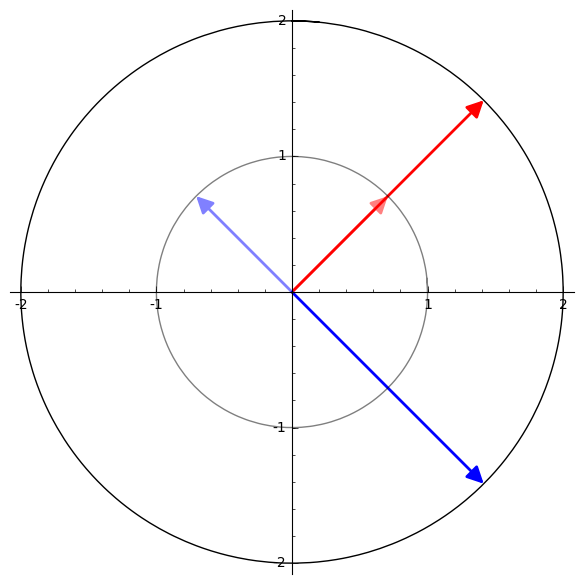

In [98]:
A = matrix([[0, 2], [2, 0]])
show(A.eigenvectors_right())
eigen_circle = plot_eigen_circle(A)
show(eigen_circle)
eigen_circle.save("eigen-circle-1.png")

[(5/3, [
  (1, 2)
  ], 1), (1/3, [
  (1, -2)
  ], 1)]

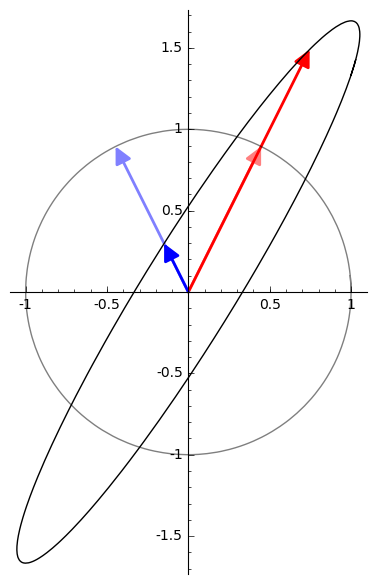

In [101]:
A = matrix([[1, 1/3], [4/3, 1]])
show(A.eigenvectors_right())
eigen_circle = plot_eigen_circle(A)
show(eigen_circle)
eigen_circle.save("eigen-circle-2.png")

In [104]:
def plot_singular_circle(A, alpha=1.0):
    A = matrix(RDF, A)
    c = (parametric_plot(transformed_circle_coords(A, x), (x, 0, 2*pi+0.1),
                        color = "black", alpha=alpha) +
         parametric_plot(vector([cos(x), sin(x)]), (x, 0, 2*pi+0.1),
                        color = "black", alpha=alpha*0.5))
    singular_vectors = A.SVD()[2]
    sv_1 = vector(singular_vectors[:, 0])
    sv_2 = vector(singular_vectors[:, 1])
    v_1 = (plot(sv_1,
              rgbcolor = (1.0, 1.0-alpha*0.5, 1.0-alpha*0.5)) +
           plot(A * sv_1,
               rgbcolor = (1.0, 1.0-alpha, 1.0-alpha)))
    v_2 = (plot(sv_2,
              rgbcolor = (1.0-alpha*0.5, 1.0-alpha*0.5, 1.0)) +
           plot(A * sv_2,
               rgbcolor = (1.0-alpha, 1.0-alpha, 1.0)))
    return plot(c + v_1 + v_2)

[-0.8506508083520399 -0.5257311121191336]
[-0.5257311121191336  0.8506508083520399] [ 1.9513673220832282                 0.0]
[                0.0 0.28470065541656153]

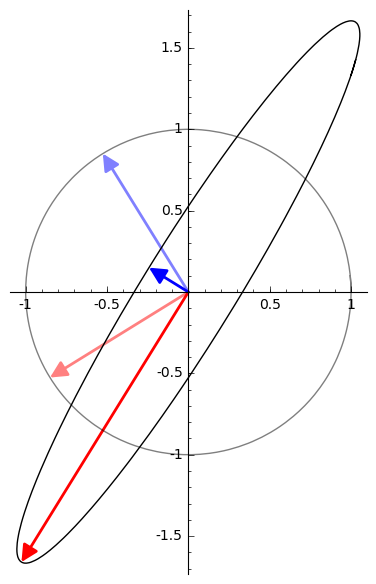

In [201]:
A = matrix(RDF, [[1, 1/3], [4/3, 1]])
show(A.SVD()[2], A.SVD()[1])
singular_circle = plot_singular_circle(A)
show(singular_circle)
singular_circle.save("singular-circle-1.png")

In [157]:
def axes(xmin=-1,xmax=1,ymin=-1,ymax=1,zmin=-1,zmax=1,**kwds):
    ex = vector((1,0,0))
    ey = vector((0,1,0))
    ez = vector((0,0,1))
    G =  line3d([xmin*ex,xmax*ex],**kwds)
    G += line3d([ymin*ey,ymax*ey],**kwds)
    G += line3d([zmin*ez,zmax*ez],**kwds)
    return G

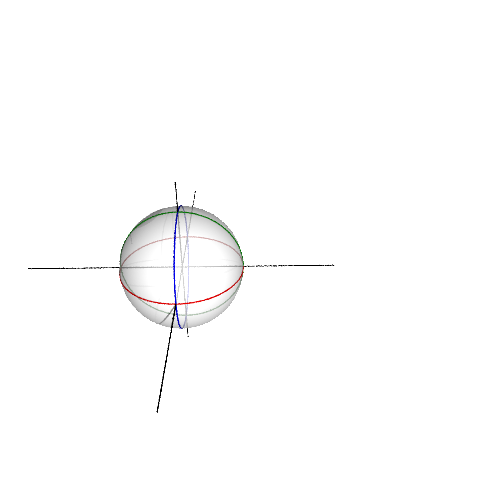

In [498]:
a = 1
b = 1
c = 1
sph = surfaces.Ellipsoid(center = (0, 0, 0), axes = (a, b, c))
sph_plot = (ell.plot(aspect_ratio = 1, opacity = 0.7, color = "lightgray", 
         plot_points = [300, 300],
         frame = False,
         viewer = "tachyon", antialiasing = 4, xres = 800, yres = 800, zoom = 1.5) +
 parametric_plot((a*cos(u), b*sin(u), 0), (u, 0, 2*pi), color = "red") +
 parametric_plot((0, b*cos(u), c*sin(u)), (u, 0, 2*pi), color = "green") +
 parametric_plot((a*cos(u), 0, c*sin(u)), (u, 0, 2*pi), color = "blue") +
 axes(xmin = -3, xmax = 3, ymin = -2.5, ymax = 2.5, zmin = -1.5, zmax = 1.5, color = "black", opacity = 1.0)).rotateZ(pi/4)
sph_plot.save("sphere.png", figsize = [11, 8.5])
show(sph_plot)

In [542]:
A = (matrix([[cos(pi/4), -sin(pi/4), 0], [sin(pi/4), cos(pi/4), 0], [0, 0, 1]])
     * matrix([[3, 0, 0], [0, 2, 0], [0, 0, 1]]))
show(A)
U, S, V = matrix(RDF, A).SVD()
show(U.round(2), S, V.round(2))
latex(A)
latex((U, S, V))

[3/2*sqrt(2)    -sqrt(2)           0]
[3/2*sqrt(2)     sqrt(2)           0]
[          0           0           1]

[-0.71 -0.71   0.0]
[-0.71  0.71   0.0]
[  0.0   0.0   1.0] [3.0000000000000004                0.0                0.0]
[               0.0                2.0                0.0]
[               0.0                0.0                1.0] [-1.0  0.0  0.0]
[-0.0  1.0  0.0]
[-0.0  0.0  1.0]

\left(\left(\begin{array}{rrr}
-0.707106781187 & -0.707106781187 & 0.0 \\
-0.707106781187 & 0.707106781187 & 0.0 \\
0.0 & 0.0 & 1.0
\end{array}\right), \left(\begin{array}{rrr}
3.0 & 0.0 & 0.0 \\
0.0 & 2.0 & 0.0 \\
0.0 & 0.0 & 1.0
\end{array}\right), \left(\begin{array}{rrr}
-1.0 & 0.0 & 0.0 \\
-0.0 & 1.0 & 0.0 \\
-0.0 & 0.0 & 1.0
\end{array}\right)\right)

In [470]:
def plot_singular_ellipsoid(A, opacity = 1.0):
    A = matrix(RDF, A)
    ellipsoid = parametric_plot(A*vector([sin(u)*cos(v),
                                          sin(u)*sin(v),
                                          cos(u)]),
                                (u, 0, 2*pi),
                                (v, 0, 2*pi),
                               color = "lightgray",
                               opacity = opacity,
                               plot_points = [300, 300])
    ellipses = (parametric_plot(A*vector([cos(u),
                                          sin(u),
                                          0]),
                                (u, 0, 2*pi), 
                                color = "red", thickness = 1) +
                parametric_plot(A*vector([0,
                                          cos(u),
                                          sin(u)]),
                                (u, 0, 2*pi), 
                                color = "green", thickness = 1) +
                parametric_plot(A*vector([cos(u),
                                          0,
                                          sin(u)]),
                                (u, 0, 2*pi), 
                                 color = "blue", thickness = 1))
    _, _, V = matrix(RDF, A).SVD()
    singular_vectors = V
    sv_1 = vector(singular_vectors[:, 0])
    sv_2 = vector(singular_vectors[:, 1])
    sv_3 = vector(singular_vectors[:, 2])
    v_1 = plot(A*sv_1, thickness = 2, color = "black")
    v_2 = plot(A*sv_2, thickness = 2, color = "black")
    v_3 = plot(A*sv_3, thickness = 2, color = "black")
    vectors = v_1 + v_2 + v_3
    objects = (ellipsoid + ellipses + vectors)
    ax = axes(xmin = -3.0, xmax = 3.0,
              ymin = -2.5, ymax = 2.5,
              zmin = -1.5, zmax = 1.5,
              color = "black", opacity = 1.0,
             aspect_ratio = 1,
             frame = False,
             viewer = "tachyon", 
             antialiasing = 4,
             xres = 800, yres = 800,
             zoom = 1.5)
    p = (objects + ax).rotateZ(pi/4)
    return p

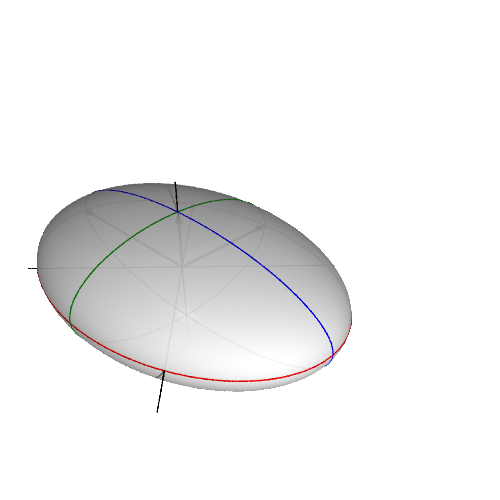

In [490]:
ell_plot = plot_singular_ellipsoid(A, opacity = 0.7)
ell_plot.save("ellipsoid.png", figsize = [11, 8.5])
show(ell_plot)

In [576]:
def plot_singular_ellipses(A, colors = ["red", "green", "blue"]):
    A = matrix(RDF, A)
    ellipses = (parametric_plot(A*vector([cos(u),
                                          sin(u),
                                          0]),
                                (u, 0, 2*pi), 
                                color = colors[0], thickness = 2, opacity = 0.7) +
                parametric_plot(A*vector([0,
                                          cos(u),
                                          sin(u)]),
                                (u, 0, 2*pi), 
                                color = colors[1], thickness = 2, opacity = 0.7) +
                parametric_plot(A*vector([cos(u),
                                          0,
                                          sin(u)]),
                                (u, 0, 2*pi), 
                                 color = colors[2], thickness = 2, opacity = 0.7))
    _, _, V = matrix(RDF, A).SVD()
    singular_vectors = V
    sv_1 = vector(singular_vectors[:, 0])
    sv_2 = vector(singular_vectors[:, 1])
    sv_3 = vector(singular_vectors[:, 2])
    v_1 = plot(A*sv_1, thickness = 2, color = "black")
    v_2 = plot(A*sv_2, thickness = 2, color = "black")
    v_3 = plot(A*sv_3, thickness = 2, color = "black")
    vectors = v_1 + v_2 + v_3
    objects = (ellipses + vectors)
    ax = axes(xmin = -3.0, xmax = 3.0,
              ymin = -2.5, ymax = 2.5,
              zmin = -1.5, zmax = 1.5,
              color = "black", opacity = 1.0,
             aspect_ratio = 1,
             frame = False,
             viewer = "tachyon", 
             antialiasing = 1,
             xres = 800, yres = 800,
             camera_center = (4, 4, 4),
             zoom = 1.5)
    p = (objects + ax).rotateZ(pi/4)
    return p

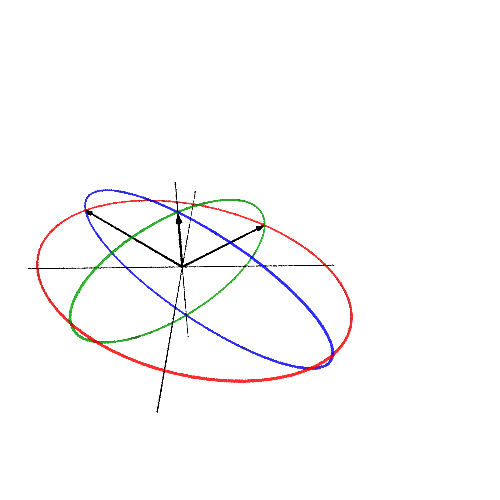

In [577]:
eps_plot = plot_singular_ellipses(A)
eps_plot.save("ellipses.png", figsize = [11, 8.5])
show(eps_plot)

In [532]:
def plot_singular_circle2(A, alpha=1.0, circle_color = "black", axes_labels = ["x", "y"]):
    A = matrix(RDF, A)
    c = (parametric_plot(transformed_circle_coords(A, x), (x, 0, 2*pi+0.1),
                        color = circle_color, alpha = alpha) +
         parametric_plot(vector([cos(x), sin(x)]), (x, 0, 2*pi+0.1),
                        color = circle_color, alpha=alpha*0.5))
    singular_vectors = A.SVD()[2]
    sv_1 = vector(singular_vectors[:, 0])
    sv_2 = vector(singular_vectors[:, 1])
    v_1 = (plot(sv_1, color = "lightgray") + plot(A*sv_1, color = "black"))
    v_2 = (plot(sv_2, color = "lightgray") + plot(A*sv_2, color = "black"))
    return plot(c + v_1 + v_2)

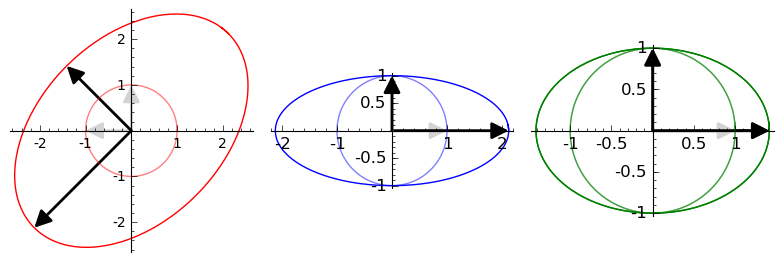

In [597]:
# Would need to change into standard basis in R^2 for each to get the actual ellipses
graphics_array((plot_singular_circle2(A[[0, 1], [0, 1]], circle_color = "red"),
                plot_singular_circle2(A[[0, 2], [0, 2]], circle_color = "blue"),
                plot_singular_circle2(A[[1, 2], [1, 2]], circle_color = "green")))

In [572]:
# Obtain a lower rank approximation to $A$ by setting one of its singular values to 0.
def partial_svd(A, i):
    A = matrix(RDF, A)
    U, S, V = A.SVD()
    S = copy(S)
    S[i, :] = 0
    S[:, i] = 0
    return (U*S*V.transpose())

In [582]:
show(A)
show(partial_svd(A, 0))
show(partial_svd(A, [0, 2]))
show(partial_svd(A, [1, 2]))

[3/2*sqrt(2)    -sqrt(2)           0]
[3/2*sqrt(2)     sqrt(2)           0]
[          0           0           1]

[                0.0 -1.4142135623730951                 0.0]
[                0.0   1.414213562373095                 0.0]
[                0.0                 0.0                 1.0]

[                0.0 -1.4142135623730951                 0.0]
[                0.0   1.414213562373095                 0.0]
[                0.0                 0.0                 0.0]

[2.1213203435596433                0.0                0.0]
[ 2.121320343559643                0.0                0.0]
[               0.0                0.0                0.0]

(
[-0.7071067811865477                 0.0 -0.7071067811865475]
[ 0.7071067811865475                 0.0 -0.7071067811865477]
[                0.0                 1.0                -0.0],

[2.0 0.0 0.0]
[0.0 1.0 0.0]
[0.0 0.0 0.0],

[                0.0                 0.0 -1.0000000000000002]
[ 1.0000000000000002                 0.0                -0.0]
[                0.0                 1.0                -0.0]
)

[                0.0 -1.4142135623730951                 0.0]
[                0.0   1.414213562373095                 0.0]
[                0.0                 0.0                 1.0] (
[-0.7071067811865477                 0.0 -0.7071067811865475]
[ 0.7071067811865475                 0.0 -0.7071067811865477]
[                0.0                 1.0                -0.0],

[2.0 0.0 0.0]
[0.0 1.0 0.0]
[0.0 0.0 0.0],

[                0.0                 0.0 -1.0000000000000002]
[ 1.0000000000000002                 0.0                -0.0]
[                0.0                 1.0                -0.0]
)

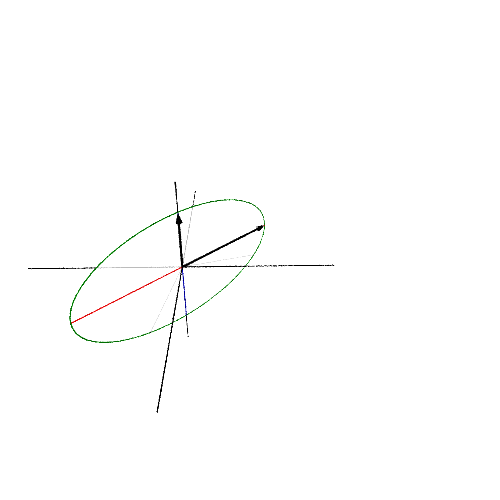

In [594]:
A_1 = partial_svd(A, 0)
show(A_1, A_1.SVD())
ellipse_2 = plot_singular_ellipsoid(A_1)
ellipse_2.save("ellipse_2.png", figsize = [11, 8.5])
show(ellipse_2)

[0.0 0.0 0.0]
[0.0 0.0 0.0]
[0.0 0.0 1.0] (
[0.0 0.0 1.0]  [1.0 0.0 0.0]  [0.0 0.0 1.0]
[0.0 1.0 0.0]  [0.0 0.0 0.0]  [0.0 1.0 0.0]
[1.0 0.0 0.0], [0.0 0.0 0.0], [1.0 0.0 0.0]
)

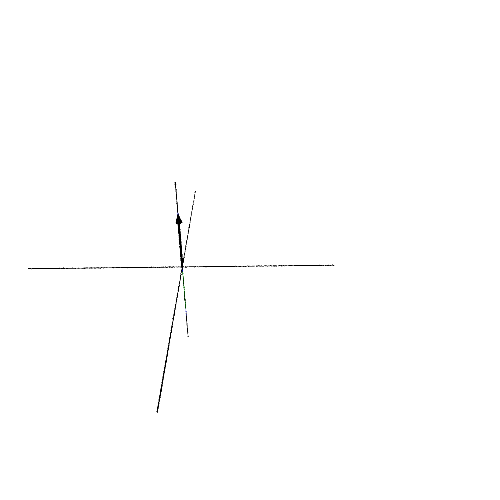

In [595]:
A_2 = partial_svd(A, [0, 1])
show(A_2, A_2.SVD())
ellipse_1 = plot_singular_ellipsoid(A_2)
ellipse_1.save("ellipse_1.png", figsize = [11, 8.5])
show(ellipse_1)

[ 2.1213203435596433 -1.4142135623730951                 0.0]
[  2.121320343559643   1.414213562373095                 0.0]
[                0.0                 0.0                 0.0] (
[-0.7071067811865475 -0.7071067811865474                 0.0]
[-0.7071067811865474  0.7071067811865477                 0.0]
[                0.0                 0.0                 1.0],

[3.000000000000001               0.0               0.0]
[              0.0               2.0               0.0]
[              0.0               0.0               0.0],

[                 -1.0 1.332267629550187e-16                   0.0]
[1.332267629550187e-16                   1.0                   0.0]
[                 -0.0                   0.0                   1.0]
)

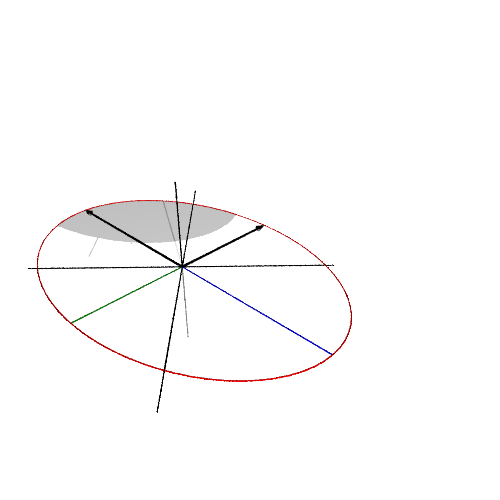

[2.1213203435596433                0.0                0.0]
[ 2.121320343559643                0.0                0.0]
[               0.0                0.0                0.0] (
[-0.7071067811865475                 0.0 -0.7071067811865475]
[-0.7071067811865475                 0.0  0.7071067811865476]
[                0.0                 1.0                 0.0],

[3.000000000000001               0.0               0.0]
[              0.0               0.0               0.0]
[              0.0               0.0               0.0],

[-1.0  0.0  0.0]
[-0.0  0.0  1.0]
[-0.0  1.0  0.0]
)

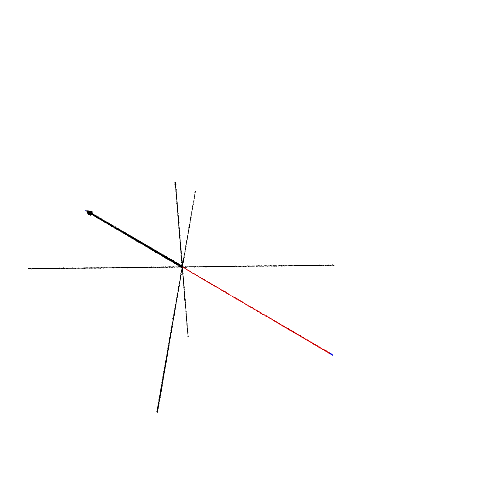

In [593]:
B_1 = partial_svd(A, 2)
show(B_1, B_1.SVD())
b_ellipse_1 = plot_singular_ellipsoid(B_1)
b_ellipse_1.save("b_ellipse_1.png", figsize = [11, 8.5])
show(b_ellipse_1)

B_2 = partial_svd(A, [1,2])
show(B_2, B_2.SVD())
b_ellipse_2 = plot_singular_ellipsoid(B_2)
b_ellipse_2.save("b_ellipse_2.png", figsize = [11, 8.5])
show(b_ellipse_2)

# Pseudoinverses

[-0.7071067811865472  0.7071067811865472]
[ 0.7071067811865475  0.7071067811865476] [1.4999999999999998                0.0]
[               0.0 0.5000000000000001] [-0.7071067811865476  0.7071067811865475]
[ 0.7071067811865475  0.7071067811865476]

('ref', 1.17809724509617)
('ref', 1.17809724509617)


Animation with 55 frames
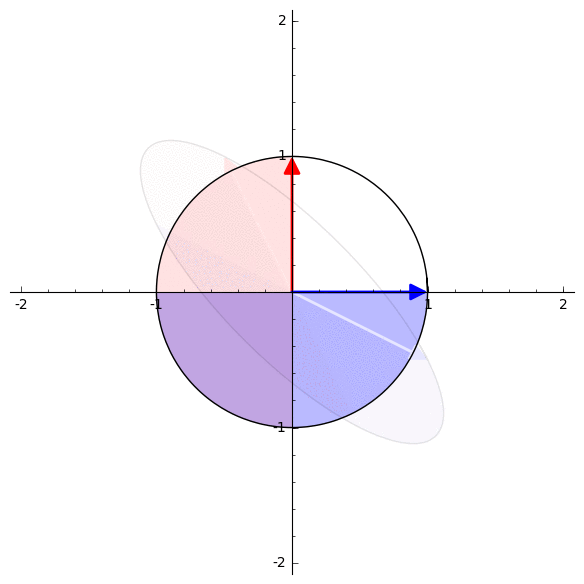

In [600]:
A = factor_and_interpolate([[1, -0.5], [-0.5, 1]])
animate_transformation(A)

In [22]:
def make_reflection_rotation(U):
    # check for rotation
    if round(U[0,0]) == round(U[1,1]) and round(det(U)) == 1:
        # \theta = \sgn(\sin \theta) \arccos(\cos \theta)
        theta = sgn(U[1,0])*arccos(U[0,0])
        print("rot", theta)
        return rotation(theta)
    # if it's not a rotation, it's a reflection
    else:
        # \theta = \frac{1}{2} \sgn(\sin 2\theta) \arccos(\cos 2\theta)
        theta = sgn(U[1,0])*0.5*arccos(U[0,0])
        print("ref", theta)
        return reflection(theta)

def factor_and_interpolate(A):
    A = matrix(RDF, A)
    U, S, V = A.SVD()
    # regularize the transformations somewhat
    if U[0, 0] < 0 and U[1, 0] < 0:
        U = copy(U)
        U.set_col_to_multiple_of_col(0, 0, -1)
        V = copy(V)
        V.set_col_to_multiple_of_col(0, 0, -1)
    show(U, S, V.transpose())
    U_t = make_reflection_rotation(U)
    S_t = scaling(S[0,0], S[1, 1])
    V_t = make_reflection_rotation(V.transpose())
    A_t = interpolate(U_t, S_t, V_t)
    return A_t

In [652]:
A = matrix(RDF, [[1, -0.5], [-0.5, 1]])
U, S, V = A.SVD()
Si = copy(S)
for i in range(min(S.ncols(), S.nrows())):
    Si[i, i] = 1/S[i, i]
B = V*Si*U.transpose()

anim_A = animate_transformation(factor_and_interpolate(A), steps = 150)
anim_B = animate_transformation(factor_and_interpolate(B), I = A, steps = 150, end_pause = 10)
anim_BA = anim_A * anim_B

anim_BA.save("invertible-equation.gif", delay = 0)

[ 0.7071067811865472  0.7071067811865472]
[-0.7071067811865475  0.7071067811865476] [1.4999999999999998                0.0]
[               0.0 0.5000000000000001] [ 0.7071067811865476  0.7071067811865475]
[-0.7071067811865475  0.7071067811865476]

('rot', -0.7853981633974487)
('rot', 0.7853981633974483)


[ 0.7071067811865474 -0.7071067811865475]
[ 0.7071067811865477  0.7071067811865476] [1.9999999999999991                0.0]
[               0.0 0.6666666666666667] [ 0.7071067811865475 -0.7071067811865477]
[ 0.7071067811865477  0.7071067811865475]

('rot', 0.7853981633974485)
('rot', -0.7853981633974484)


In [23]:
X = matrix(RDF, [[1, 1], [1, 1]])
U, S, V = X.SVD()
Si = copy(S)
for i in range(min(S.ncols(), S.nrows())):
    if S[i, i] != 0: 
        Si[i, i] = 1/S[i, i]
Xi = V*Si*U.transpose()

anim_X = animate_transformation(factor_and_interpolate(X), steps = 150)
anim_Xi = animate_transformation(factor_and_interpolate(Xi), I = X, steps = 150, end_pause = 10)
anim_XiX = anim_X * anim_Xi

#anim_XiX.save("dependent-equation.gif", delay = 0)

[ 0.7071067811865472 -0.7071067811865475]
[ 0.7071067811865475  0.7071067811865475] [2.0 0.0]
[0.0 0.0] [ 0.7071067811865476  0.7071067811865475]
[-0.7071067811865475  0.7071067811865476]

('rot', 0.7853981633974487)
('rot', -0.7853981633974483)


[ 0.7071067811865477 -0.7071067811865476]
[ 0.7071067811865477  0.7071067811865477] [   0.49999999999999983                    0.0]
[                   0.0 1.9626155733547187e-17] [ 0.7071067811865475  0.7071067811865477]
[ 0.7071067811865477 -0.7071067811865475]

('rot', 0.7853981633974481)
('ref', 0.392699081698724)


In [20]:
Xi_t = interpolate(rotation(pi/4), scaling(0.5, 0), rotation(-pi/4))

anim_X = animate_transformation(factor_and_interpolate(X), steps = 150)
anim_Xi = animate_transformation(Xi_t, I = X, steps = 150, end_pause = 10)
anim_XiX = anim_X * anim_Xi

anim_XiX.save("dependent-equation.gif", delay = 0)

[ 0.7071067811865472 -0.7071067811865475]
[ 0.7071067811865475  0.7071067811865475] [2.0 0.0]
[0.0 0.0] [ 0.7071067811865476 -0.7071067811865475]
[ 0.7071067811865475  0.7071067811865476]

('rot', 0.7853981633974487)
('rot', -0.7853981633974483)


Animation with 315 frames
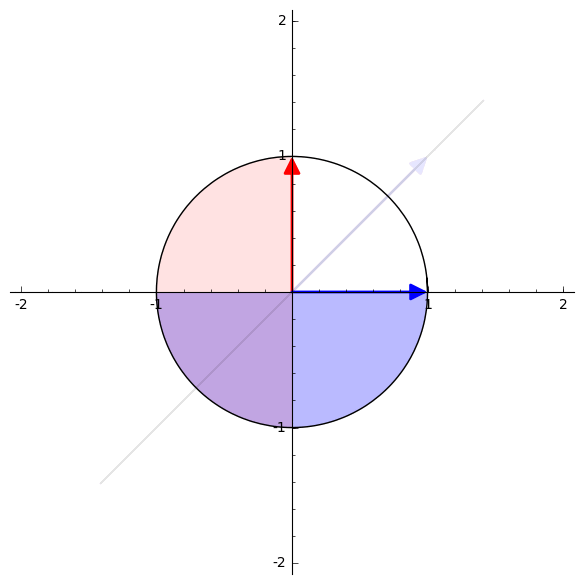

In [21]:
show(anim_XiX, delay = 0)

In [24]:
show(Xi)

[0.24999999999999992                0.25]
[ 0.2499999999999999 0.24999999999999994]

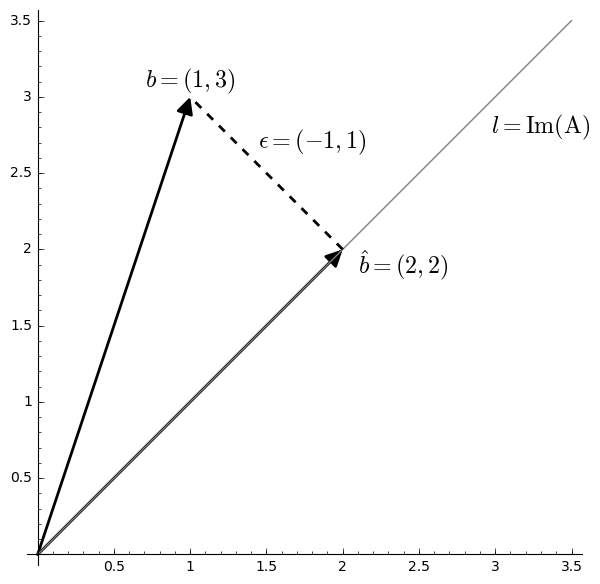

In [71]:
b = (plot(vector([1, 3]), rgbcolor = "black", aspect_ratio = 1) + 
     text("$b = (1, 3)$", (1, 3.1), fontsize = "x-large", color = "black"))
b_hat = (plot(vector([2, 2]), rgbcolor = "black") +
         text("$\hat{b} = (2, 2)$", (2.4, 1.9), fontsize = "x-large", color = "black"))
l = (line([(0, 0), (3.5, 3.5)], rgbcolor = "gray") +
     text("$l = \operatorname{Im(A)}$", (3.3, 2.8), fontsize = "x-large", color = "black"))
e = (line([(2, 2), (1, 3)], rgbcolor = "black", linestyle = "dashed", thickness = 2) +
     text("$\epsilon = (-1, 1)$", (1.8, 2.7), fontsize = "x-large", color = "black"))

img = plot(l) + plot(b) + plot(b_hat) + plot(e)
img.save("least-squares.png")
show(img)